# Grad Cam for Kaggle's Brain Comp
This notebook displays Grad Cam for the EfficientNetB0 model trained in version 5 of my EfficientNet starter notebook [here][1]. Grad Cam allows us to see where the model is giving its attention to when it makes a prediction. This helps us understand what is important in the spectrogram images. This knowledge helps us modify model architecture and/or engineer betters features in our ML models like GBT CatBoost.

[1]: https://www.kaggle.com/code/cdeotte/efficientnetb0-starter-lb-0-43

# Initialize 2xT4 GPU

In [1]:
import os, gc

import tensorflow as tf
import pandas as pd, numpy as np
import matplotlib.pyplot as plt

print('TensorFlow version =', tf.__version__)
os.environ["CUDA_VISIBLE_DEVICES"]="0"


class CFG:
    MIX = True  # use mixed precision
    VER = 5
    USE_KAGGLE_SPECTROGRAMS = True
    USE_EEG_SPECTROGRAMS = True
    LOAD_MODELS_FROM = '/kaggle/input/brain-efficientnet-models-v3-v4-v5/'  # if this equals none, then we train new models, if this equals disk path, then we load previously trained models
    BATCH = 128
    PATH = 'data/train_spectrograms/'


# use multiple gpus
gpus = tf.config.list_physical_devices('GPU')
if len(gpus)<=1: 
    strategy = tf.distribute.OneDeviceStrategy(device="/gpu:0")
    print(f'Using {len(gpus)} GPU')
else: 
    strategy = tf.distribute.MirroredStrategy()
    print(f'Using {len(gpus)} GPUs')
    

if CFG.MIX:
    tf.config.optimizer.set_experimental_options({"auto_mixed_precision": True})
    print('Mixed precision enabled')
else:
    print('Using full precision')

2024-02-03 01:24:52.549151: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-03 01:24:52.549288: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-03 01:24:52.710527: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


TensorFlow version = 2.15.0
Using 2 GPUs
Mixed precision enabled


# Load Train Data and Create Non-Overlapping Eeg Ids

In [2]:
df = pd.read_csv('data/train.csv')
TARGETS = df.columns[-6:]
print('Train shape:', df.shape )
print('Targets', list(TARGETS))

###########

train = df.groupby('eeg_id')[[
    'spectrogram_id',
    'spectrogram_label_offset_seconds'
]].agg({
    'spectrogram_id':'first',
    'spectrogram_label_offset_seconds':'min'
})

train.columns = ['spec_id','min']

tmp = df.groupby('eeg_id')[[
    'spectrogram_id',
    'spectrogram_label_offset_seconds'
]].agg({
    'spectrogram_label_offset_seconds':'max'
})

train['max'] = tmp

tmp = df.groupby('eeg_id')[['patient_id']].agg('first')
train['patient_id'] = tmp

tmp = df.groupby('eeg_id')[TARGETS].agg('sum')
for t in TARGETS:
    train[t] = tmp[t].values
    
y_data = train[TARGETS].values
y_data = y_data / y_data.sum(axis=1, keepdims=True)
train[TARGETS] = y_data

tmp = df.groupby('eeg_id')[['expert_consensus']].agg('first')
train['target'] = tmp

train = train.reset_index()
print('Train non-overlapp eeg_id shape:', train.shape )
train.head()

Train shape: (106800, 15)
Targets ['seizure_vote', 'lpd_vote', 'gpd_vote', 'lrda_vote', 'grda_vote', 'other_vote']
Train non-overlapp eeg_id shape: (17089, 12)


,eeg_id,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote,target
0,568657,789577333,0.0,16.0,20654,0.0,0.000000,0.25,0.000000,0.166667,0.583333,Other
1,582999,1552638400,0.0,38.0,20230,0.0,0.857143,0.00,0.071429,0.000000,0.071429,LPD
2,642382,14960202,1008.0,1032.0,5955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other
3,751790,618728447,908.0,908.0,38549,0.0,0.000000,1.00,0.000000,0.000000,0.000000,GPD
4,778705,52296320,0.0,0.0,40955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other


# Read Train Spectrograms and EEG Spectrograms

In [3]:
READ_SPEC_FILES = False

# READ ALL SPECTROGRAMS
files = os.listdir(CFG.PATH)
print(f'There are {len(files)} spectrogram parquets')

if READ_SPEC_FILES:    
    spectrograms = {}
    for i,f in enumerate(files):
        if i%100==0: print(i,', ',end='')
        tmp = pd.read_parquet(f'{CFG.PATH}{f}')
        name = int(f.split('.')[0])
        spectrograms[name] = tmp.iloc[:,1:].values
else:
    spectrograms = np.load('brain_spectrograms/specs.npy', allow_pickle=True).item()
    
###########

READ_EEG_SPEC_FILES = False

if READ_EEG_SPEC_FILES:
    all_eegs = {}
    for i,e in enumerate(train.eeg_id.values):
        if i%100==0: print(i,', ',end='')
        x = np.load(f'brain_eeg_spectrograms/EEG_Spectrograms/{e}.npy')
        all_eegs[e] = x
else:
    all_eegs = np.load('brain_eeg_spectrograms/eeg_specs.npy', allow_pickle=True).item()
    
print(f'There are {len(all_eegs)} eeg parquets')

There are 11138 spectrogram parquets
There are 17089 eeg parquets


# DataLoader

In [4]:
import albumentations as albu
TARS = {'Seizure':0, 'LPD':1, 'GPD':2, 'LRDA':3, 'GRDA':4, 'Other':5}
TARS2 = {x:y for y, x in TARS.items()}

class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, batch_size=32, shuffle=False, augment=False, mode='train',
                 specs = spectrograms, eeg_specs = all_eegs): 
        self.data = data
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.augment = augment
        self.mode = mode
        self.specs = specs
        self.eeg_specs = eeg_specs
        self.on_epoch_end()
        
    def __len__(self):
        'Denotes the number of batches per epoch'
        ct = int( np.ceil( len(self.data) / self.batch_size ) )
        return ct

    def __getitem__(self, index):
        'Generate one batch of data'
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        X, y = self.__data_generation(indexes)
        if self.augment: X = self.__augment_batch(X) 
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange( len(self.data) )
        if self.shuffle: np.random.shuffle(self.indexes)
                        
    def __data_generation(self, indexes):
        'Generates data containing batch_size samples' 
        
        X = np.zeros((len(indexes),128,256,8),dtype='float32')
        y = np.zeros((len(indexes),6),dtype='float32')
        img = np.ones((128,256),dtype='float32')
        
        for j,i in enumerate(indexes):
            row = self.data.iloc[i]
            if self.mode=='test': 
                r = 0
            else: 
                r = int( (row['min'] + row['max'])//4 )

            for k in range(4):
                # extract 300 rows of spectrogram
                img = self.specs[row.spec_id][r: r + 300, k * 100: (k + 1) * 100].T
                
                # log transform spectrogram
                img = np.clip(img, np.exp(-4), np.exp(8))
                img = np.log(img)
                
                # standardize per image
                ep = 1e-6
                m = np.nanmean(img.flatten())
                s = np.nanstd(img.flatten())
                img = (img-m)/(s+ep)
                img = np.nan_to_num(img, nan=0.0)
                
                # crop to 256 time steps
                X[j, 14: -14, :, k] = img[:, 22: -22] / 2.0
        
            # eeg spectrograms
            img = self.eeg_specs[row.eeg_id]
            X[j, :, :, 4:] = img
                
            if self.mode!='test':
                y[j,] = row[TARGETS]
            
        return X, y
    
    def __random_transform(self, img):
        composition = albu.Compose([
            albu.HorizontalFlip(p=0.5),
            #albu.CoarseDropout(max_holes=8,max_height=32,max_width=32,fill_value=0,p=0.5),
        ])
        return composition(image=img)['image']
            
    def __augment_batch(self, img_batch):
        for i in range(img_batch.shape[0]):
            img_batch[i, ] = self.__random_transform(img_batch[i, ])
        return img_batch

# Build Grad Cam Model

In [5]:
# !pip install --no-index --find-links=/kaggle/input/tf-efficientnet-whl-files /kaggle/input/tf-efficientnet-whl-files/efficientnet-1.1.1-py3-none-any.whl

Looking in links: /kaggle/input/tf-efficientnet-whl-files
Processing /kaggle/input/tf-efficientnet-whl-files/efficientnet-1.1.1-py3-none-any.whl
Processing /kaggle/input/tf-efficientnet-whl-files/Keras_Applications-1.0.8-py3-none-any.whl (from efficientnet==1.1.1)


In [6]:
import efficientnet.tfkeras as efn

def build_cam_model(pretrain=None):
    
    inp = tf.keras.Input(shape=(128, 256, 8))
    base_model = efn.EfficientNetB0(include_top=False, weights=None, input_shape=None)
    if pretrain:
        base_model.load_weights('tf_efficientnet_imagenet_weights/efficientnet-b0_weights_tf_dim_ordering_tf_kernels_autoaugment_notop.h5')
    
    # reshape input 128x256x8 => 512x512x3 monotone image
    # kaggle spectrograms
    x1 = [inp[:, :, :, i: i + 1] for i in range(4)]
    x1 = tf.keras.layers.Concatenate(axis=1)(x1)
    
    # eeg spectrograms
    x2 = [inp[:,:,:,i+4:i+5] for i in range(4)]
    x2 = tf.keras.layers.Concatenate(axis=1)(x2)
    
    # make 512 x 512 x 3
    if CFG.USE_KAGGLE_SPECTROGRAMS & CFG.USE_EEG_SPECTROGRAMS:
        x = tf.keras.layers.Concatenate(axis=2)([x1, x2])
    elif CFG.USE_EEG_SPECTROGRAMS: 
        x = x2
    else: 
        x = x1
    x = tf.keras.layers.Concatenate(axis=3)([x, x, x])
    
    # output
    x0 = base_model(x)
    x = tf.keras.layers.GlobalAveragePooling2D()(x0)
    x = tf.keras.layers.Dense(6, activation='softmax', dtype='float32')(x)
        
    # compile model
    model = tf.keras.Model(inputs=inp, outputs=[x, x0])
    opt = tf.keras.optimizers.Adam(learning_rate=1e-3)
    loss = tf.keras.losses.KLDivergence()

    model.compile(loss=loss, optimizer = opt) 
        
    return model

In [7]:
from sklearn.model_selection import GroupKFold

gkf = GroupKFold(n_splits=5)
for fold, (train_index, valid_index) in enumerate(gkf.split(train, train.target, train.patient_id)): 
    # load weights into grad cam model
    with strategy.scope():
        model = build_cam_model()    
    model.load_weights(f'{CFG.LOAD_MODELS_FROM}EffNet_v{CFG.VER}_f{fold}.h5')
    layer_weights = model.layers[-1].get_weights()[0][:, 0]
    break
    
print('Using fold 0 model and inferring fold 0 OOF (out of fold) samples...')

Using fold 0 model and inferring fold 0 OOF (out of fold) samples...


# Display Grad Cam

In [8]:
import cv2

# helper function
def mask2contour(mask, width=5):
    w = mask.shape[1]
    h = mask.shape[0]
    mask2 = np.concatenate([mask[:, width:], np.zeros((h, width))], axis=1)
    mask2 = np.logical_xor(mask, mask2)
    mask3 = np.concatenate([mask[width:, :], np.zeros((width, w))], axis=0)
    mask3 = np.logical_xor(mask, mask3)
    return np.logical_or(mask2, mask3) 

clahe = cv2.createCLAHE(clipLimit=16.0, tileGridSize=(8, 8))


#########################
### SEIZURE_VOTE
#########################
Found 555 samples in fold zero OOF for seizure_vote with true>0.5

==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.960 lpd=0.002 gpd=0.022 lrda=0.002 grda=0.003 other=0.010


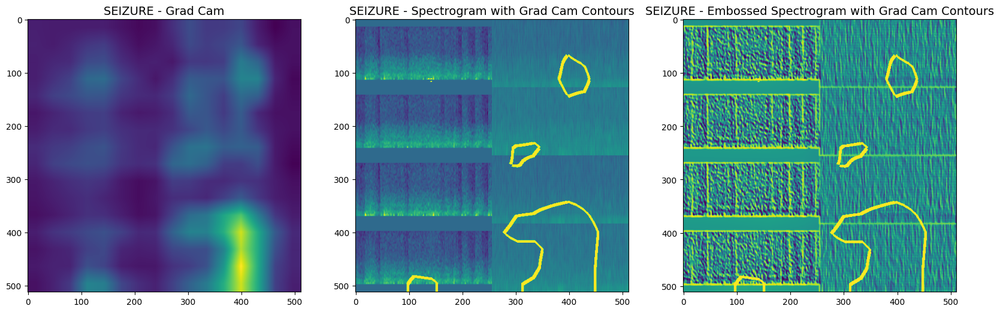

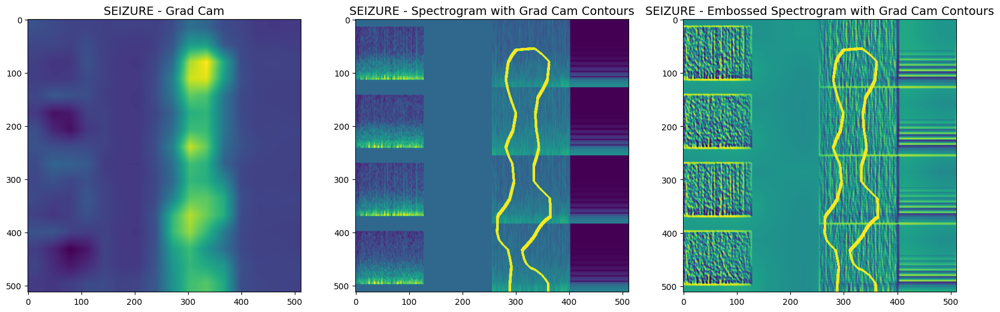


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.915 lpd=0.002 gpd=0.001 lrda=0.017 grda=0.004 other=0.061


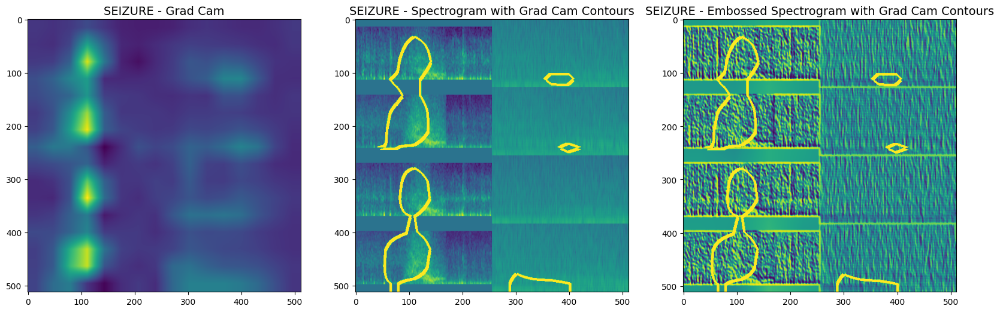


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.767 lpd=0.018 gpd=0.001 lrda=0.117 grda=0.004 other=0.094


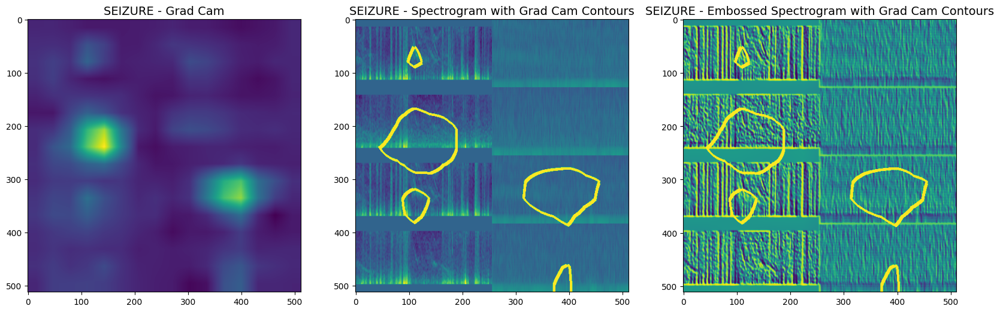


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.981 lpd=0.013 gpd=0.003 lrda=0.001 grda=0.000 other=0.002


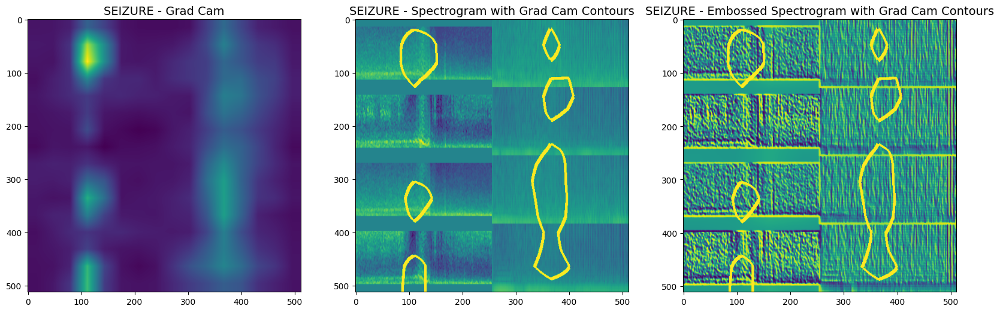


==> TRUE:  seizure=0.667 lpd=0.000 gpd=0.333 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.583 lpd=0.015 gpd=0.264 lrda=0.008 grda=0.029 other=0.101


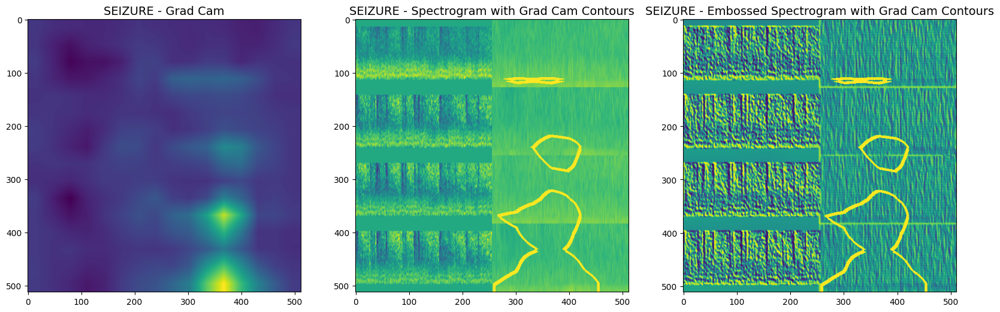


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.964 lpd=0.002 gpd=0.000 lrda=0.008 grda=0.000 other=0.025


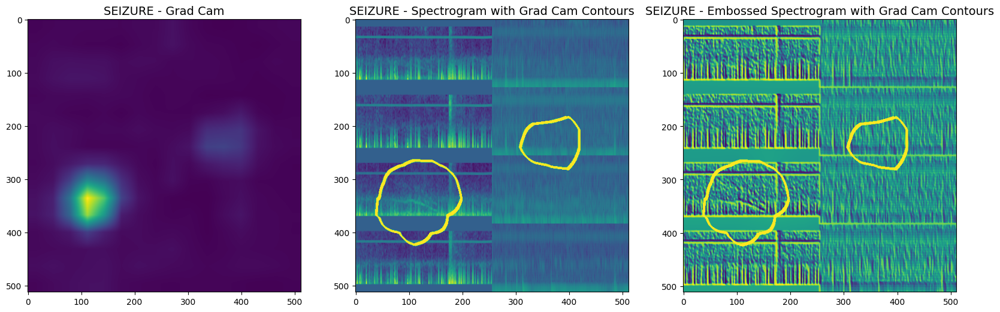


#########################
### LPD_VOTE
#########################
Found 347 samples in fold zero OOF for lpd_vote with true>0.5

==> TRUE:  seizure=0.000 lpd=0.750 gpd=0.000 lrda=0.250 grda=0.000 other=0.000
==> PRED:  seizure=0.005 lpd=0.908 gpd=0.001 lrda=0.020 grda=0.001 other=0.065


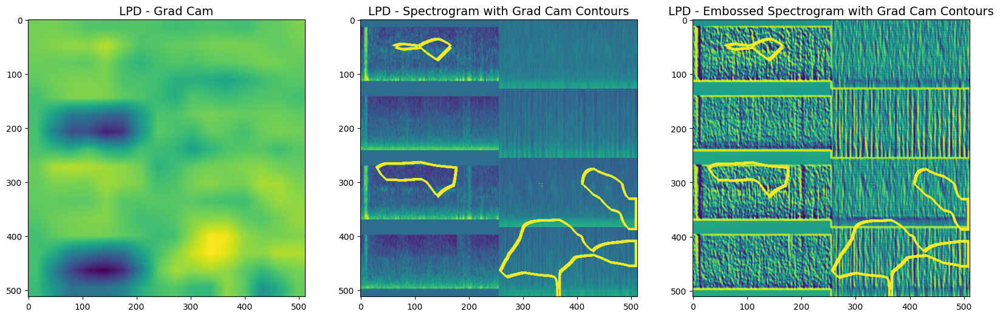


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.015 lpd=0.601 gpd=0.025 lrda=0.003 grda=0.001 other=0.356


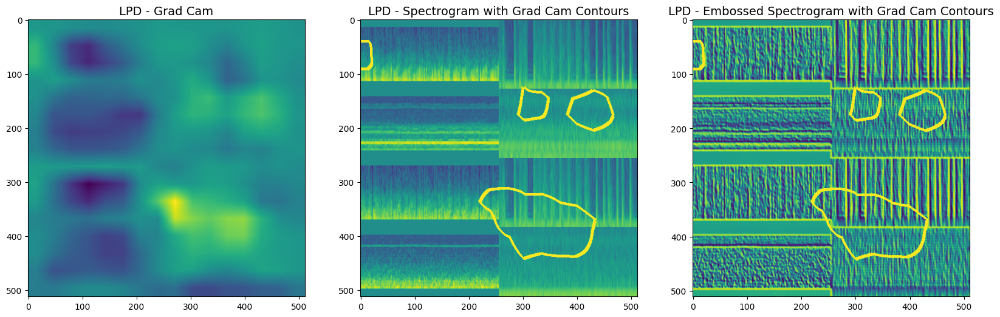


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.023 lpd=0.608 gpd=0.012 lrda=0.103 grda=0.004 other=0.250


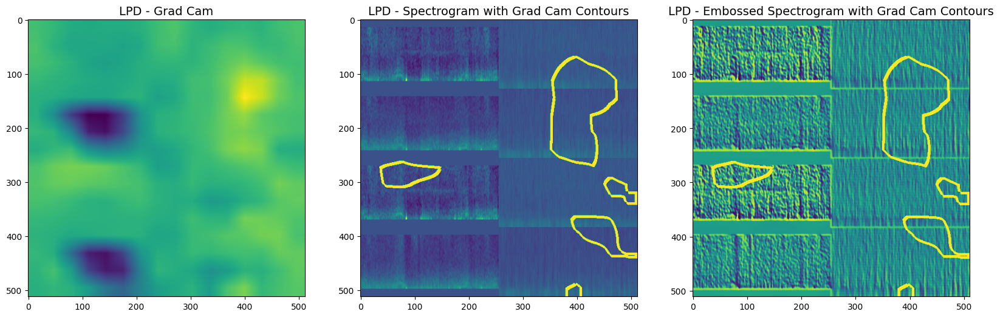


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.020 lpd=0.604 gpd=0.007 lrda=0.175 grda=0.007 other=0.186


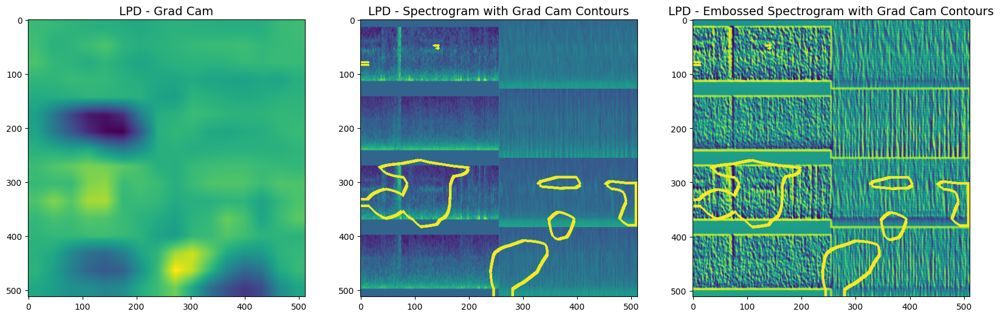


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.018 lpd=0.932 gpd=0.002 lrda=0.001 grda=0.000 other=0.047


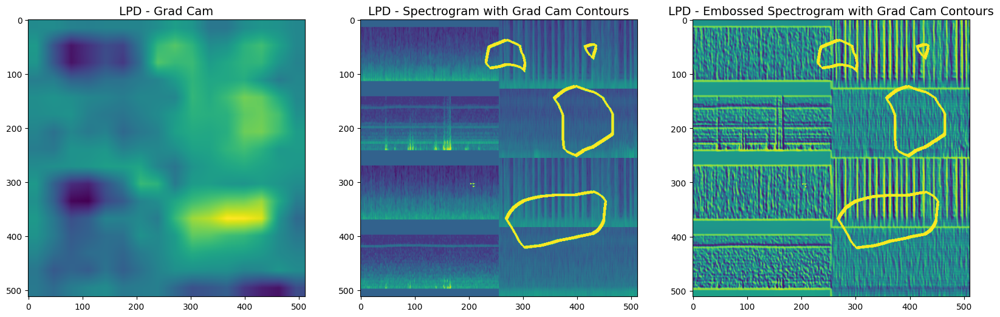


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.004 lpd=0.890 gpd=0.001 lrda=0.030 grda=0.001 other=0.074


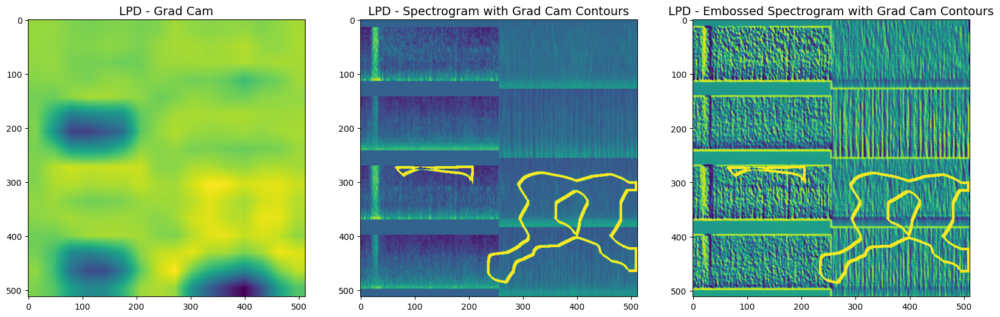


==> TRUE:  seizure=0.000 lpd=0.929 gpd=0.000 lrda=0.071 grda=0.000 other=0.000
==> PRED:  seizure=0.000 lpd=0.995 gpd=0.002 lrda=0.001 grda=0.000 other=0.002


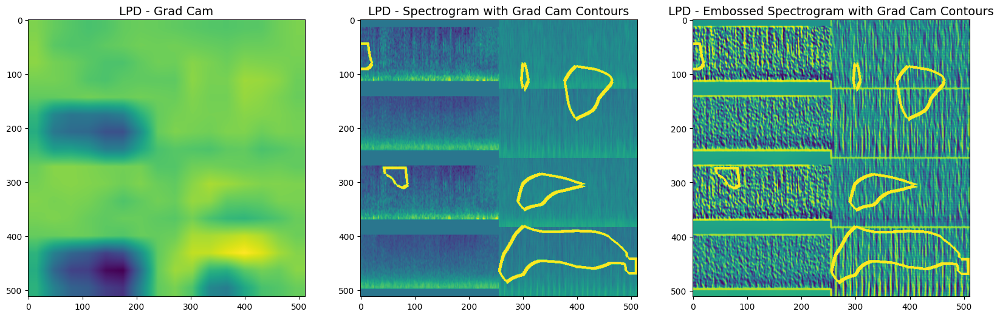


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.016 lpd=0.922 gpd=0.004 lrda=0.001 grda=0.000 other=0.056


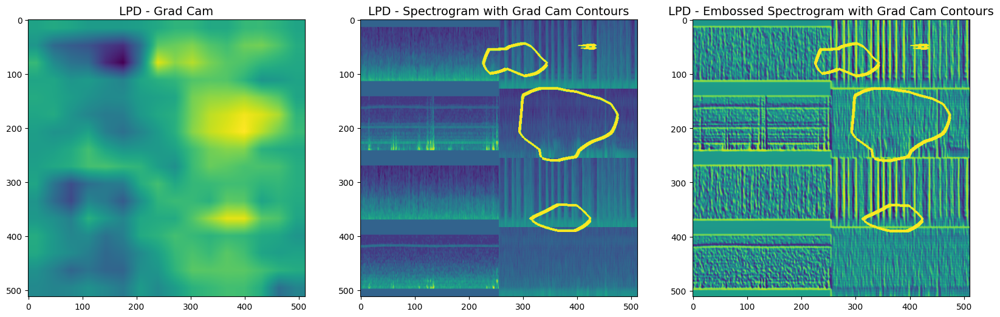


#########################
### GPD_VOTE
#########################
Found 366 samples in fold zero OOF for gpd_vote with true>0.5

==> TRUE:  seizure=0.083 lpd=0.000 gpd=0.917 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.025 lpd=0.004 gpd=0.933 lrda=0.001 grda=0.020 other=0.017


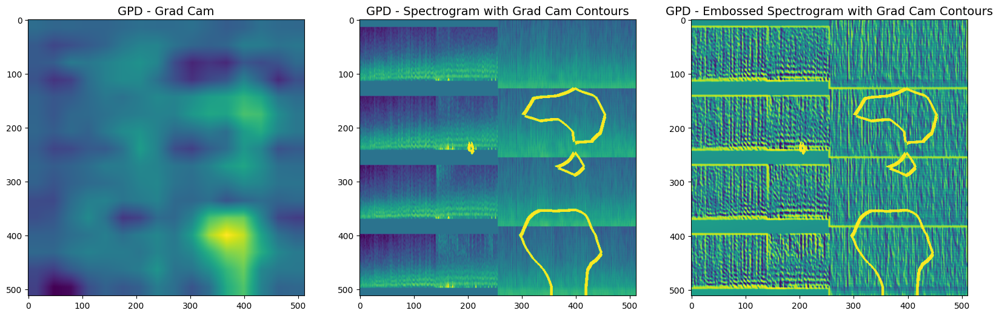


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.003 lpd=0.068 gpd=0.794 lrda=0.007 grda=0.065 other=0.063


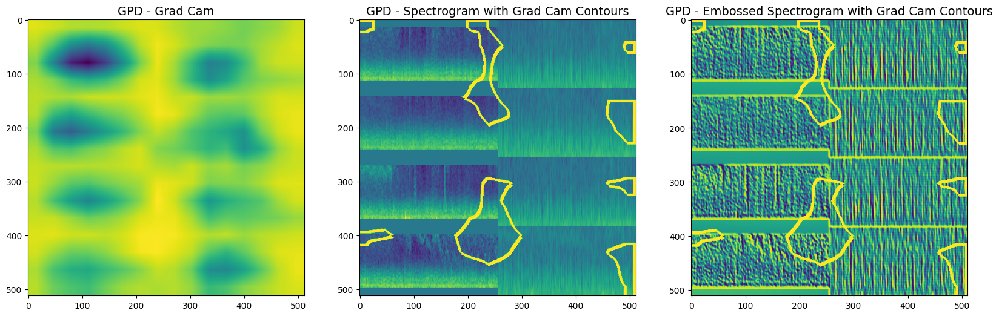


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.039 lpd=0.008 gpd=0.854 lrda=0.001 grda=0.009 other=0.089


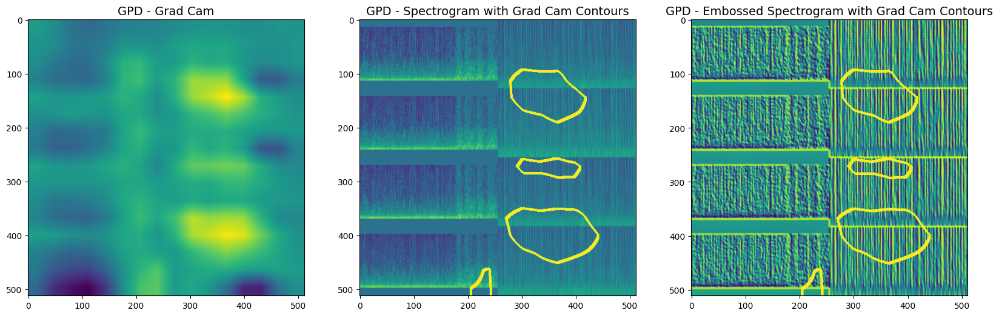


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.615 lrda=0.000 grda=0.000 other=0.385
==> PRED:  seizure=0.005 lpd=0.092 gpd=0.630 lrda=0.003 grda=0.007 other=0.262


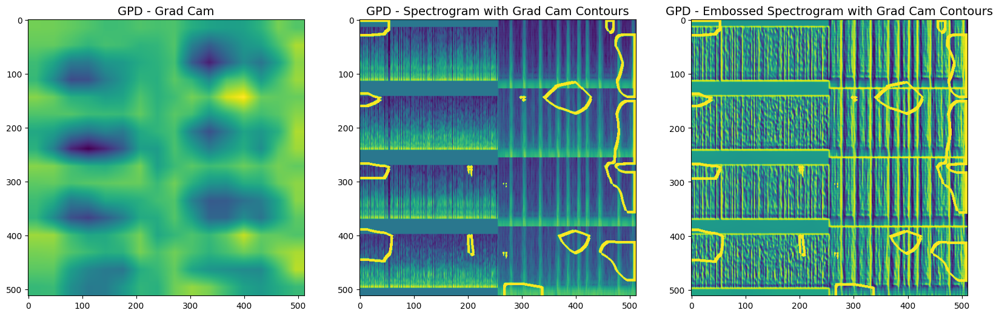


==> TRUE:  seizure=0.500 lpd=0.000 gpd=0.500 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.341 lpd=0.016 gpd=0.579 lrda=0.005 grda=0.020 other=0.039


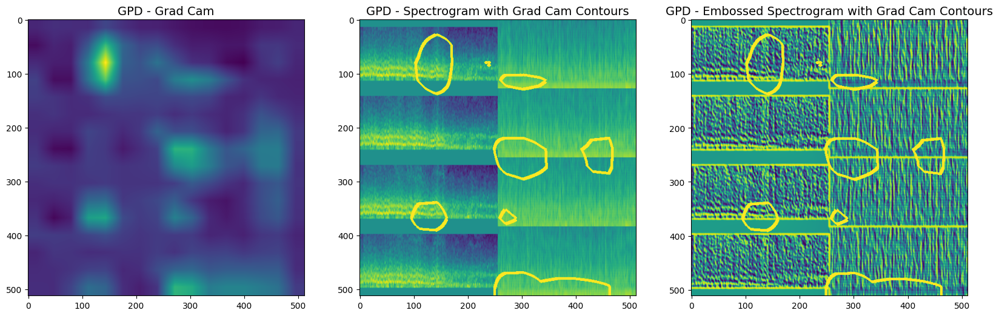


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.030 lpd=0.067 gpd=0.788 lrda=0.004 grda=0.028 other=0.083


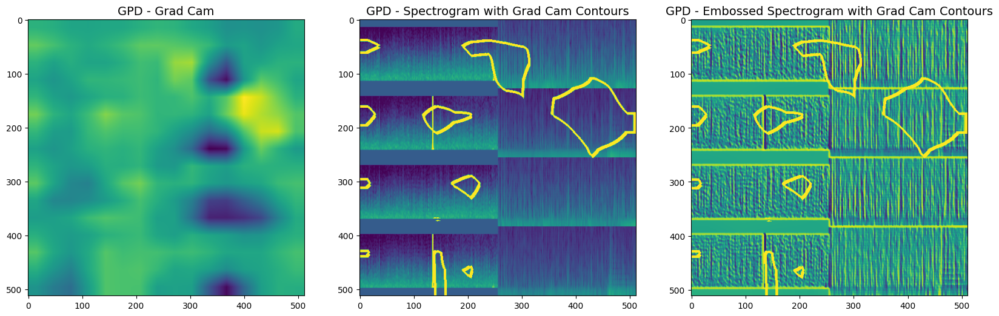


==> TRUE:  seizure=0.000 lpd=0.143 gpd=0.500 lrda=0.000 grda=0.000 other=0.357
==> PRED:  seizure=0.046 lpd=0.137 gpd=0.557 lrda=0.011 grda=0.029 other=0.220


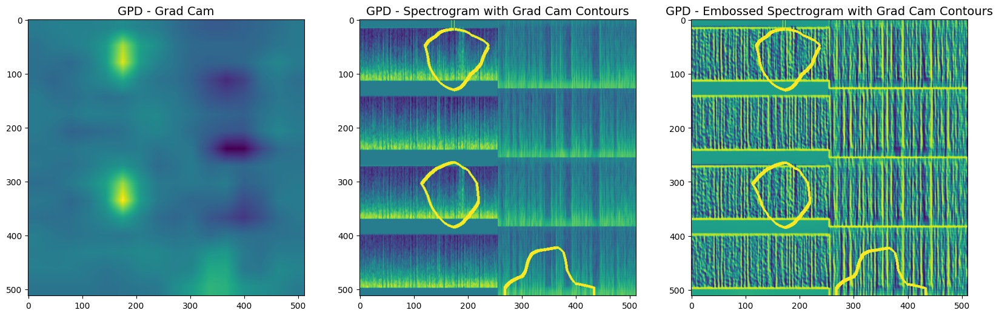


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.929 lrda=0.000 grda=0.071 other=0.000
==> PRED:  seizure=0.065 lpd=0.078 gpd=0.808 lrda=0.003 grda=0.012 other=0.033


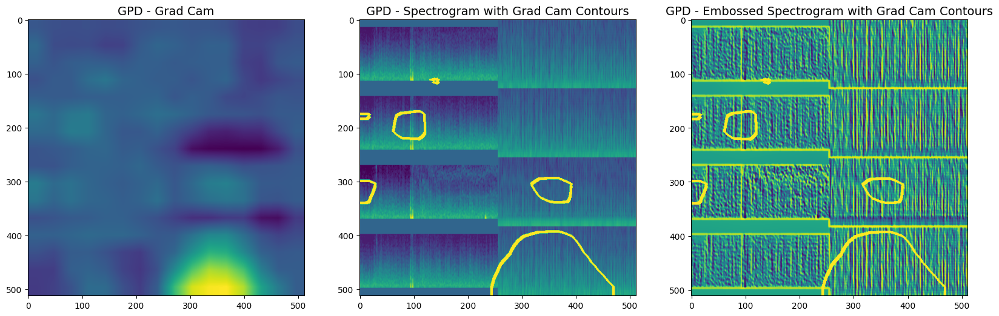


#########################
### LRDA_VOTE
#########################
Found 273 samples in fold zero OOF for lrda_vote with true>0.5

==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=1.000 grda=0.000 other=0.000
==> PRED:  seizure=0.006 lpd=0.006 gpd=0.001 lrda=0.777 grda=0.167 other=0.043


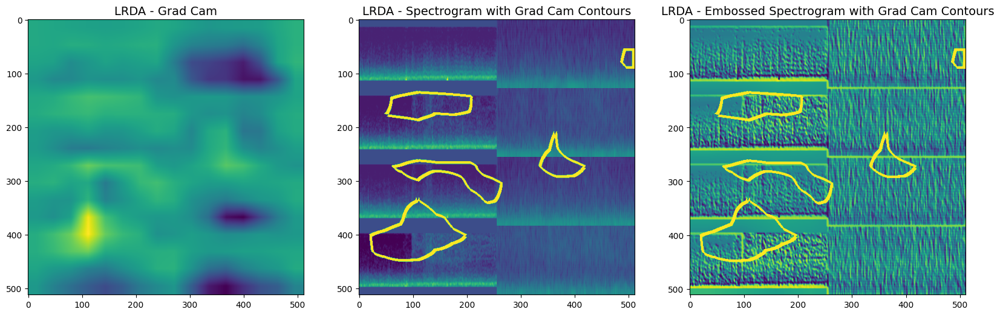


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.800 grda=0.000 other=0.200
==> PRED:  seizure=0.002 lpd=0.001 gpd=0.000 lrda=0.963 grda=0.005 other=0.029


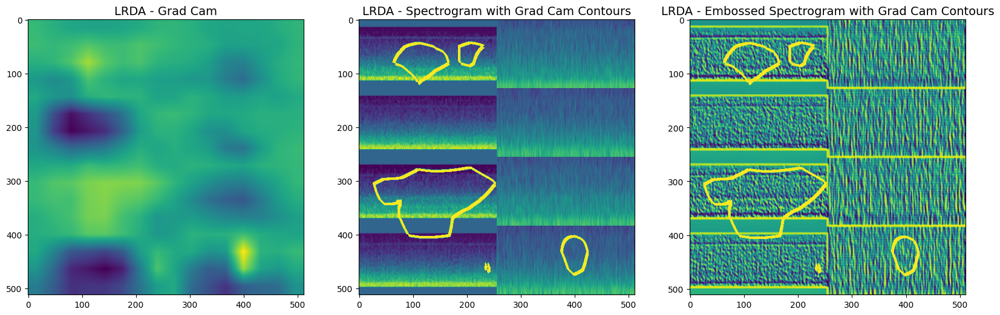


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.500 grda=0.250 other=0.250
==> PRED:  seizure=0.000 lpd=0.002 gpd=0.000 lrda=0.960 grda=0.014 other=0.023


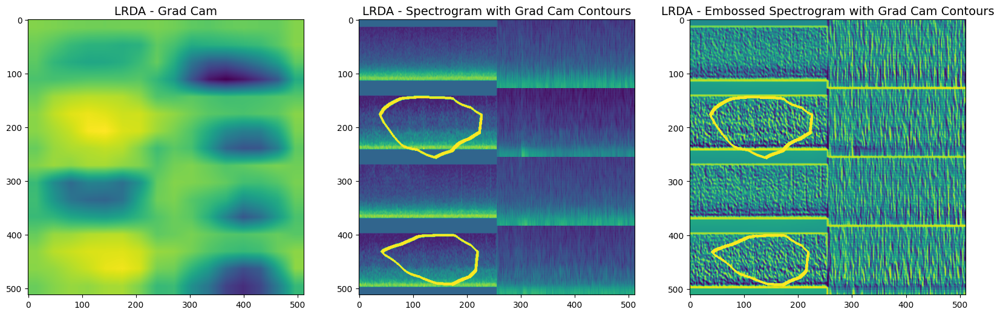


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=1.000 grda=0.000 other=0.000
==> PRED:  seizure=0.004 lpd=0.004 gpd=0.000 lrda=0.923 grda=0.012 other=0.057


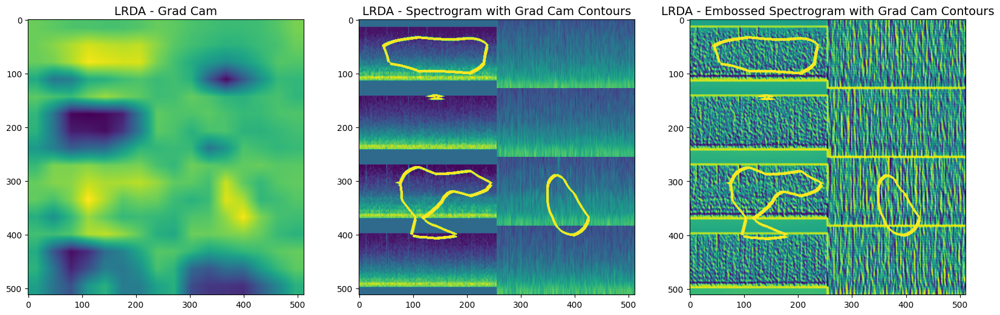


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=1.000 grda=0.000 other=0.000
==> PRED:  seizure=0.002 lpd=0.003 gpd=0.000 lrda=0.980 grda=0.001 other=0.014


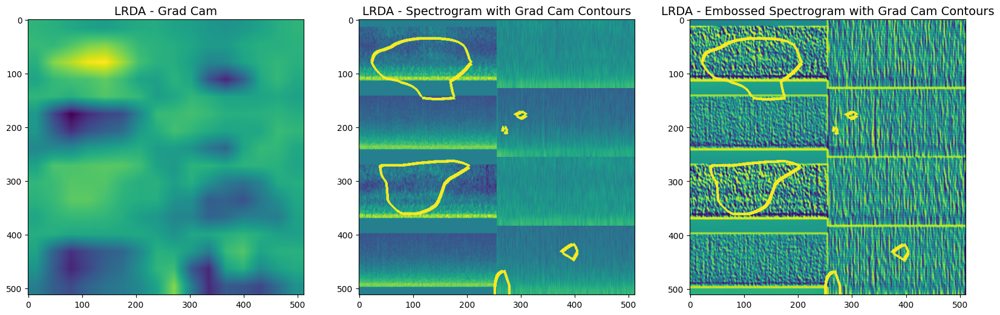


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.667 grda=0.333 other=0.000
==> PRED:  seizure=0.201 lpd=0.027 gpd=0.005 lrda=0.521 grda=0.124 other=0.122


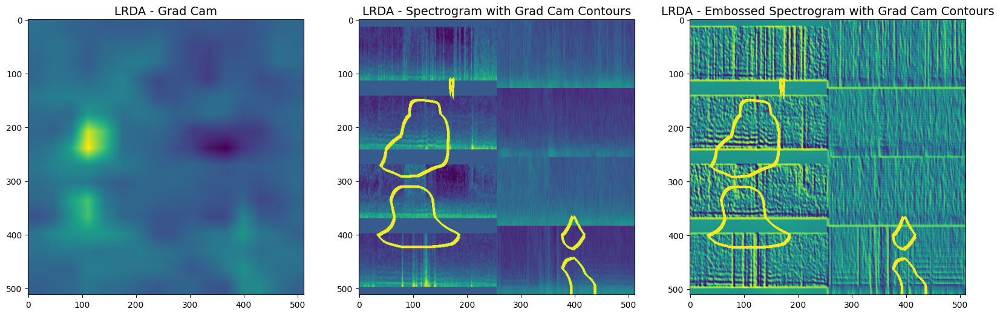


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.538 grda=0.000 other=0.462
==> PRED:  seizure=0.001 lpd=0.002 gpd=0.000 lrda=0.965 grda=0.003 other=0.029


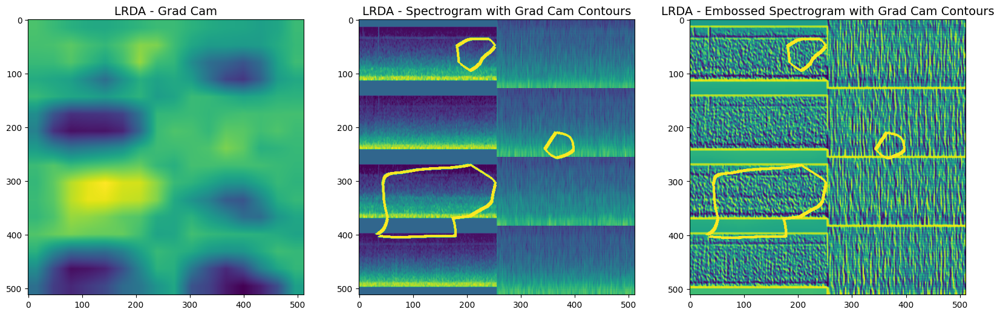


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.643 grda=0.000 other=0.357
==> PRED:  seizure=0.012 lpd=0.007 gpd=0.001 lrda=0.557 grda=0.034 other=0.389


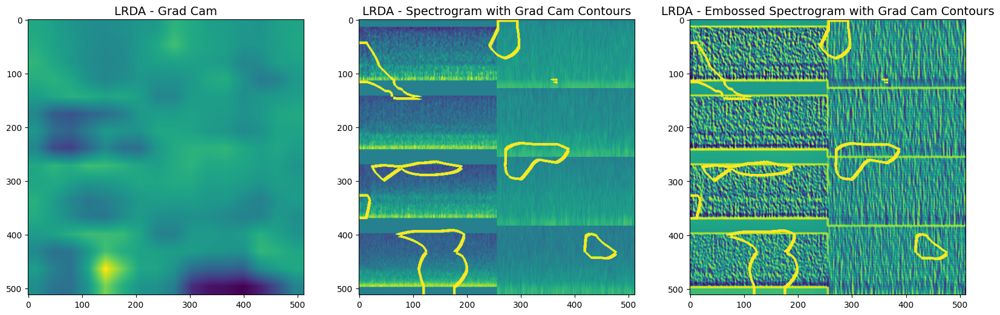


#########################
### GRDA_VOTE
#########################
Found 289 samples in fold zero OOF for grda_vote with true>0.5

==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.036 lpd=0.002 gpd=0.003 lrda=0.046 grda=0.881 other=0.033


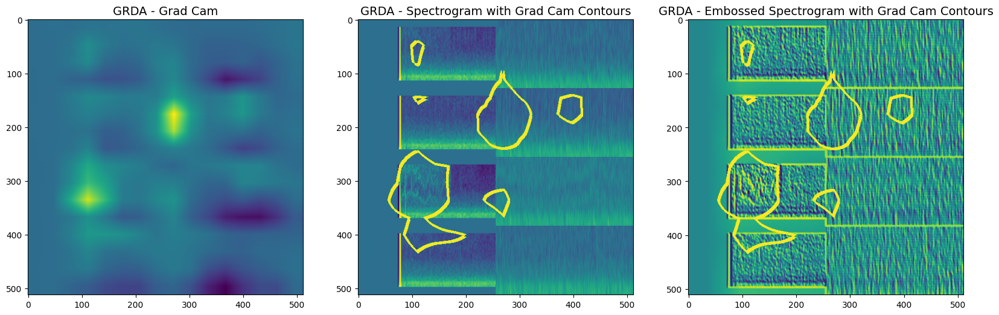


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.003 lpd=0.002 gpd=0.004 lrda=0.091 grda=0.782 other=0.118


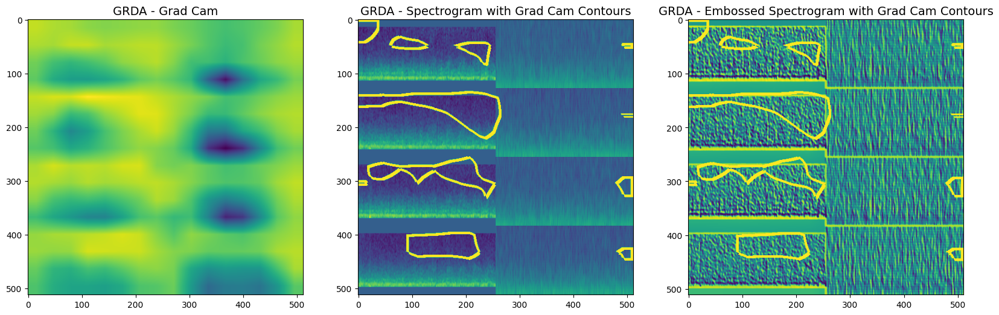


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.010 lpd=0.022 gpd=0.035 lrda=0.074 grda=0.558 other=0.300


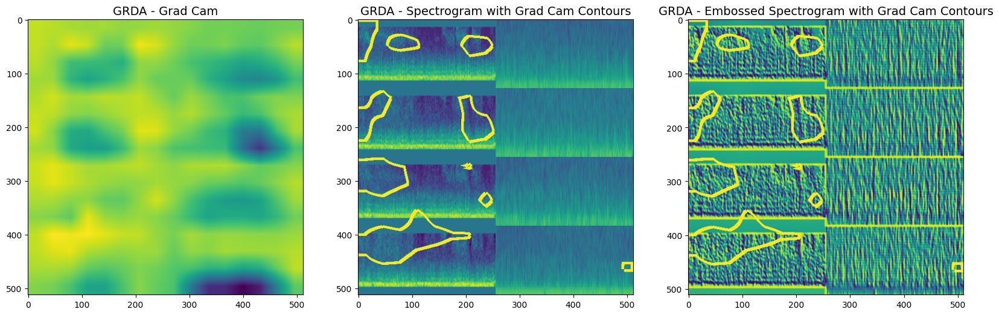


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.003 lpd=0.000 gpd=0.008 lrda=0.010 grda=0.749 other=0.229


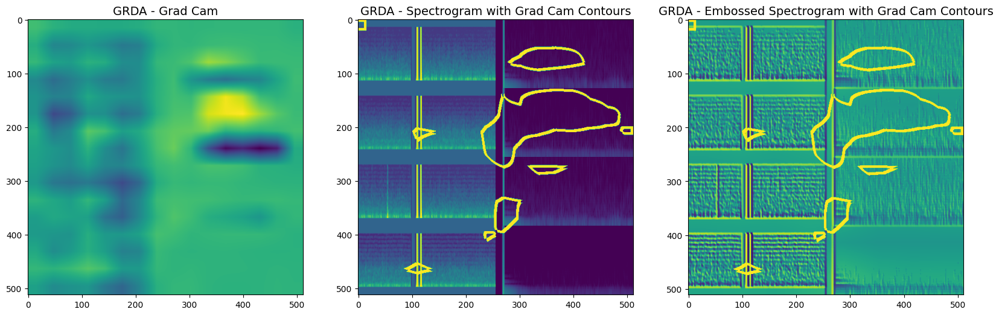


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.000 lpd=0.000 gpd=0.001 lrda=0.008 grda=0.952 other=0.039


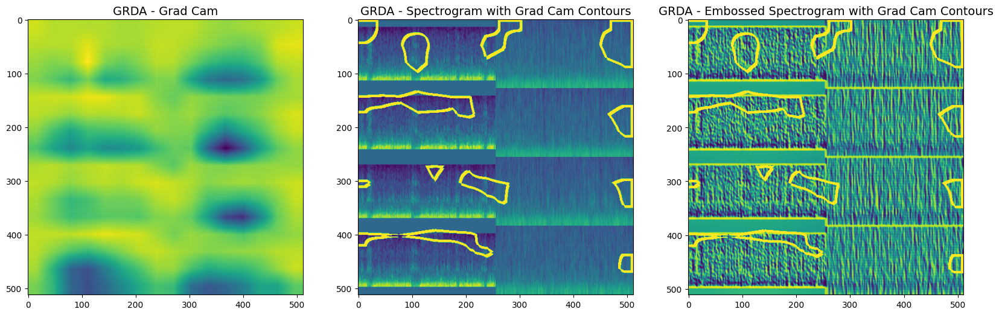


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.001 lpd=0.001 gpd=0.002 lrda=0.039 grda=0.572 other=0.385


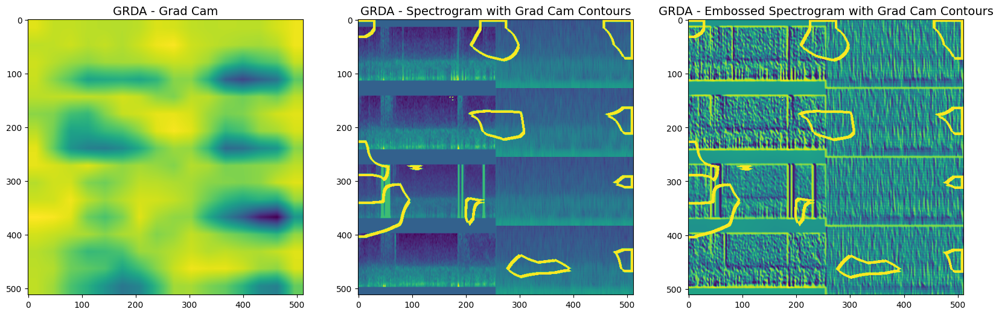


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.030 lpd=0.002 gpd=0.001 lrda=0.106 grda=0.708 other=0.153


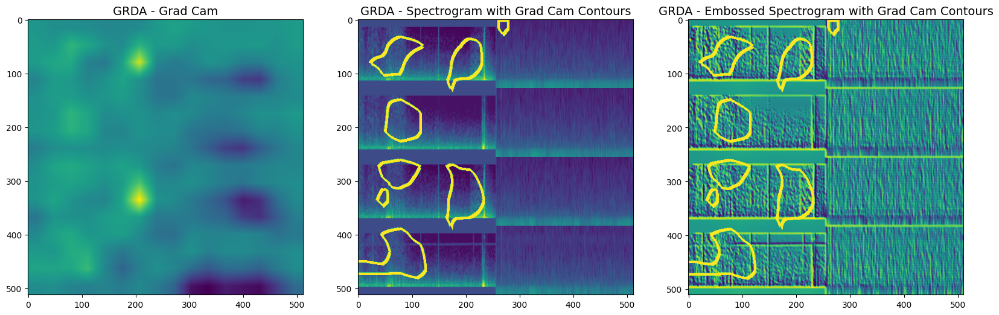


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.184 lpd=0.022 gpd=0.010 lrda=0.096 grda=0.648 other=0.041


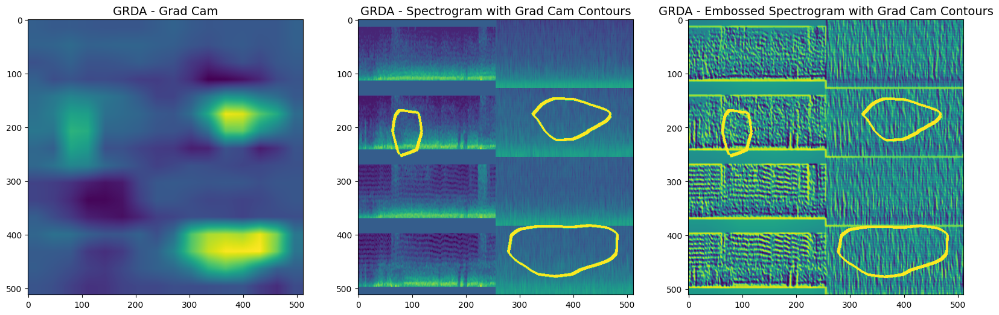


#########################
### OTHER_VOTE
#########################
Found 1398 samples in fold zero OOF for other_vote with true>0.5

==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.016 lpd=0.027 gpd=0.050 lrda=0.092 grda=0.297 other=0.518


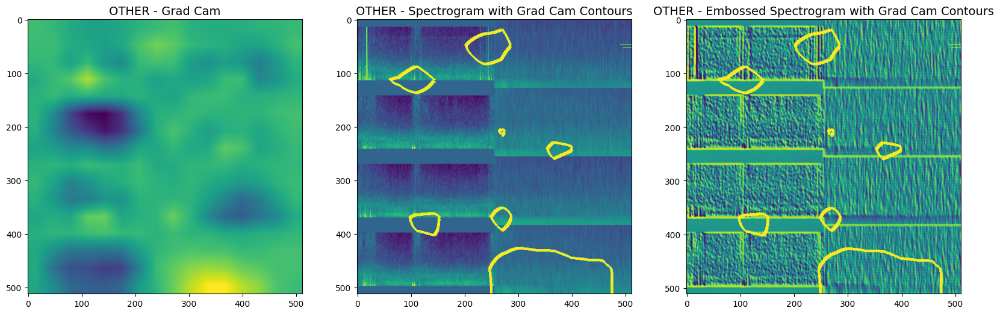


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.001 lpd=0.001 gpd=0.000 lrda=0.023 grda=0.037 other=0.938


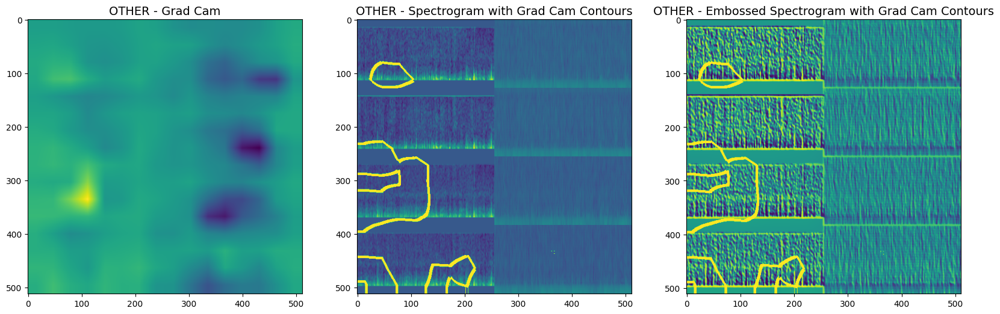


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.001 lpd=0.012 gpd=0.001 lrda=0.003 grda=0.002 other=0.981


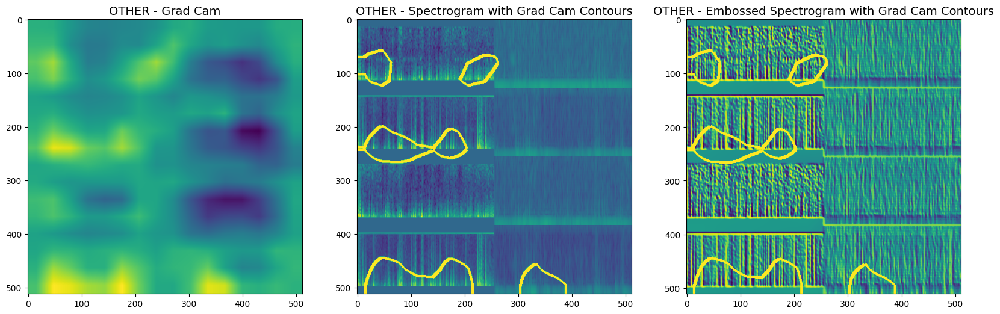


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.100 grda=0.000 other=0.900
==> PRED:  seizure=0.004 lpd=0.005 gpd=0.001 lrda=0.045 grda=0.058 other=0.887


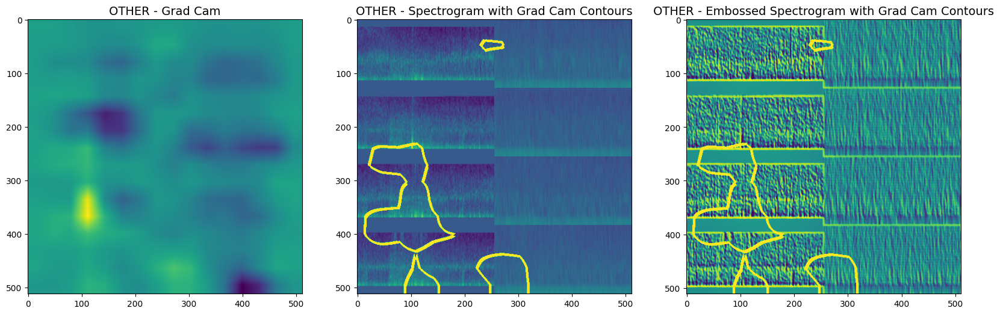


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.059 lrda=0.000 grda=0.059 other=0.882
==> PRED:  seizure=0.171 lpd=0.002 gpd=0.008 lrda=0.036 grda=0.025 other=0.759


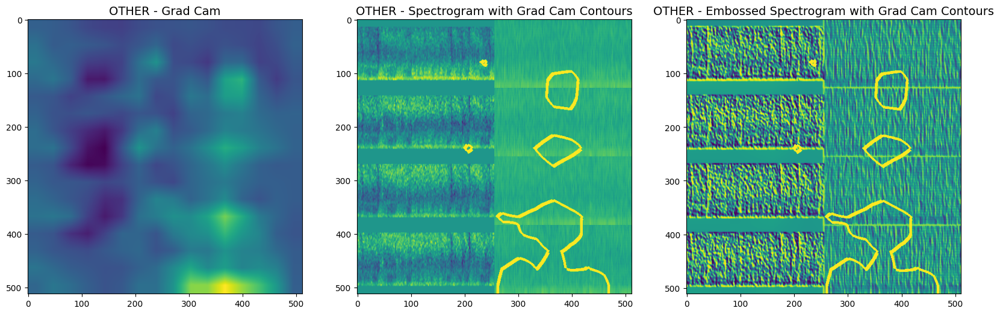


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.009 lpd=0.000 gpd=0.001 lrda=0.007 grda=0.007 other=0.975


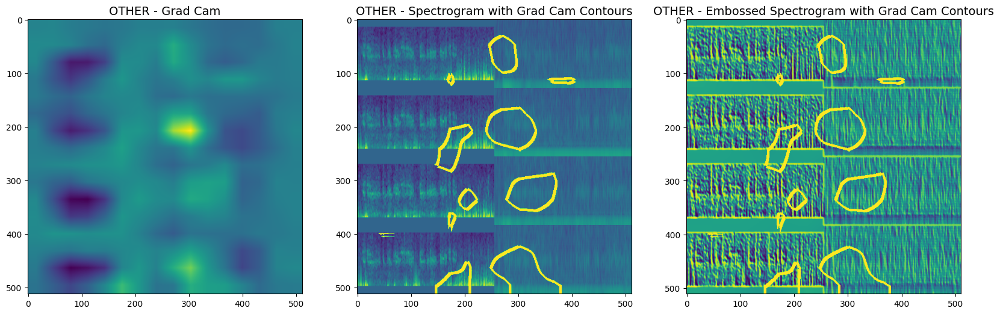


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.006 lpd=0.008 gpd=0.000 lrda=0.008 grda=0.007 other=0.970


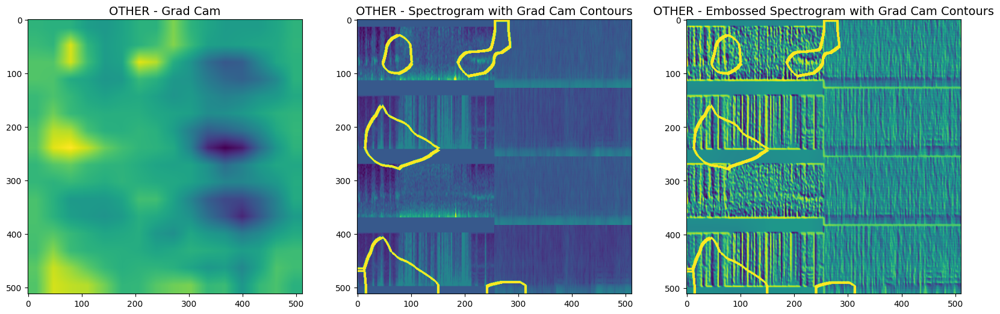


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.024 lpd=0.002 gpd=0.002 lrda=0.008 grda=0.071 other=0.894


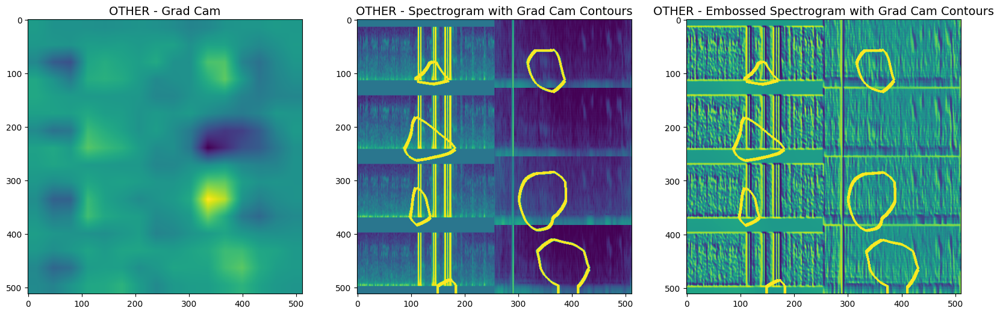

In [9]:
for ii,tt in enumerate(TARGETS):
    ttt = tt.split('_')[0].upper()
    
    print()
    print('#' * 25)
    print('###', tt.upper())
    print('#' * 25)
    
    # find train samples in oof (out of fold) with target >= 0.5
    IDX = train.loc[train.index.isin(valid_index) & (train[tt] >= 0.5), TARGETS].index.values
    print(f'Found {len(IDX)} samples in fold zero OOF for {tt} with true>0.5')
    
    # infer train samples with model (save preds and activations)
    valid_gen = DataGenerator(
        train.iloc[IDX[:128]], 
        shuffle=False, 
        batch_size=CFG.BATCH, 
        mode='valid'
    )
    
    p, xx = model.predict(valid_gen, verbose=0)
    # print(xx.shape)
    
    # display grad cam
    for x, y in valid_gen:
        ct = 0
        for i in range(CFG.BATCH):
            
            # find samples with pred >= 0.5 for target
            if i>=len(p): continue
            pred = p[i]
            if pred[ii]<0.5: continue
                
            # format predictions as string
            pred2 = '' 
            true2 = ''
            true = train.loc[IDX[i]][TARGETS].values
            for j, t in enumerate(TARGETS):
                n = t.split('_')[0]
                pred2 += f' {n}={pred[j]:0.3f}'
                true2 += f' {n}={true[j]:0.3f}'
            print()
            print('==> TRUE:', true2)
            print('==> PRED:', pred2)

            # plot grad cam results
            plt.figure(figsize=(20, 8))

            # plot grad cam image (plot 1 of 3)
            plt.subplot(1, 3, 1)
            img = np.sum(xx[i,] * layer_weights, axis=-1)
            img = cv2.resize(img, (512, 512))
            plt.imshow(img[::-1, ])
            plt.title(f'{ttt} - Grad Cam', size=14)

            # find grad cam contours for areas of interest
            cut = np.percentile(img.flatten(), [90])[0]
            cntr = img.copy()
            cntr[cntr>=cut] = 100
            cntr[cntr<cut] = 0
            cntr = mask2contour(cntr)

            # plot embossed spectrograms with gradcam contours (plot 3 of 3)
            plt.subplot(1, 3, 3)
            x1 = [x[i, :, :, k: k + 1] for k in range(4)]  # kaggle LL RL LP RP
            x1 = np.concatenate(x1, axis=0)  
            x2 = [x[i, :, :, k + 4: k + 5] for k in [0, 2, 1, 3]]  # fix order LL RL LP RP
            x2 = np.concatenate(x2, axis=0)
            x3 = np.concatenate([x1, x2], axis=1)
            img = cv2.resize(x3, (512, 512))
            img0 = img.copy()

            # emboss image for image feature visibility
            img = img[1:,1:] - img[:-1, :-1] #emboss
            img -= np.min(img)
            img /= np.max(img)
            img = (img*255).astype('uint8')
            img = cv2.GaussianBlur(img, (5, 5), 0)
            img = clahe.apply(img)
            mx = np.max(img)

            cntr2 = cntr[1:,1:]
            img[cntr2>0] = mx
            plt.imshow(img[::-1,])
            plt.title(
                f'{ttt} - Embossed Spectrogram with Grad Cam Contours', 
                size=14
            )

            # plot spectrograms with gradcam contours (plot 2 of 3)
            plt.subplot(1, 3, 2)        
            mx = np.max(img0)
            img0[cntr>0] = mx
            plt.imshow(img0[::-1, ])
            plt.title(f'{ttt} - Spectrogram with Grad Cam Contours', size=14)
            plt.show()
            ct += 1
            if ct==8: 
                break
        break